# Problem 2 - Bloch It! 

Bob has recently read about the Bloch Sphere representation of a quantum state and is feeling confident. After getting bored from all he could read about it, he asks his teacher Hilbert to give him a problem to brush up his skills. Hilbert gladly agrees and proposes a setting for Bob - 

- You are given an initial state of $|\Psi\rangle$. 
- This state can be chosen from the eigenstates of the Pauli Gates $X,\ Y\ and\ Z$ i.e. from the set $|0\rangle, |1\rangle, |+\rangle, |-\rangle, |r\rangle\ and\ |l\rangle$ where all these states can be represented on the Bloch Sphere as (in order of naming)- 
<hr>
<img src='eigen-states.png'>
<hr>

- You are also given 3 arrays, $AR_z,\ AR_x,\ AR_y$ which have sizes $n,\ m,\ k$ respectively. 
- Each of the elements of the array mean the following - 
    - If $AR_z[i]\ =\ r_1$, means current state vector is rotated counter-clockwise by an amount $\frac{r_1\pi}{2}$ about the $Z$ axis 
    - If $AR_x[j]\ =\ r_2$, means current state vector is rotated counter-clockwise by an amount $\frac{r_2\pi}{2}$ about the $X$ axis 
    - If $AR_y[k]\ =\ r_3$, means current state vector is rotated counter-clockwise by an amount $\frac{r_3\pi}{2}$ about the $Y$ axis 
 
#### Bloch Operation
- It is defined as a list of 3 indices $[i,j,k]$ such that applying the rotations $[AR_z[i], AR_x[j], AR_y[k]]$ (in the same order) will take the initial state of this operation say $|\Phi\rangle$ to the $|0\rangle$ state.
- More formally if $AR_z[i]\ =\ r_1$, $AR_x[j]\ =\ r_2$ and $AR_y[k]\ =\ r_3$, - 

    $$R_y(\frac{r_3\pi}{2})R_x(\frac{r_2\pi}{2})R_z(\frac{r_1\pi}{2})|\Phi\rangle = |0\rangle$$

## Task
- Your task is to bring this initial state $|\Psi\rangle$ to the $|0\rangle$ state by doing a **bloch operation** and count the total number of **bloch operations** which are possible
- The problems contain different versions of this task, each with different levels of difficulty
- For all levels, intial state $|\Psi\rangle$ is selected from the set $|0\rangle, |1\rangle, |+\rangle, |-\rangle, |r\rangle\ and\ |l\rangle$

### Level 1 - 20 points 
- Given the initial state $|\Psi\rangle$, your task is to build one-element lists for a valid **bloch operation**.
- Eg. 
    - If you are given a state $|0\rangle$, a valid bloch operation is going to be [0,0,0] with the lists as $AR_z\ =\ [0],\ AR_x\ =\ [2]\ and\ AR_y\ =\ [-2]$
    - The following code block highlights how the $|0\rangle$ state is converted to the $|0\rangle$ yet again after this series of operations.
    
- You can play around with the widget generated from the `visualize_transition` function to understand the problem better

In [1]:
from qiskit import QuantumCircuit
from qiskit.visualization import visualize_transition
import numpy as np

# build the quantum circuit
q = QuantumCircuit(1)

# init the state
# already |0>

# apply transformation
q.rz(0, 0)
q.rx(2*np.pi/2, 0)
q.ry(-2*np.pi/2, 0)

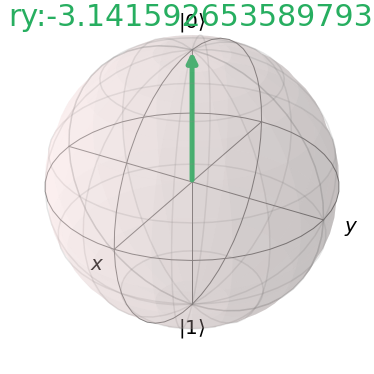

In [2]:
visualize_transition(q)

#### To submit 
- Create a function which should accept a parameter `state` from one of the characters '0', '1', '+', '-', 'r', 'l' 
- It should return a list `rotations` containing 3 integers where `rotations[0], rotations[1], rotations[2]` are the counter-clockwise rotations about the Z axis, X axis and Y axis respectively 
- These rotations, when applied in order, should transform the given state to the $|0\rangle$ state


**NOTE** 
1. Please refrain from adding any kinds of statements other than comments in the designated code block, this may result in wrong output 
2. You can assume that the input state is always going to be a valid character

#### Function

In [1]:
def generate_bloch_operation(state):
    rotation = [0,0,0]
    ### Your code goes here 
   
    
    ### Your code goes here 
    
    return rotation 

In [91]:
from grader import grader1

In [ ]:
from grader import grader1 
grader1.evaluate(generate_bloch_operation)

### Level 2 - 30 points
- Here we start to get interesting! 
- You are still given an initial state $|\Psi\rangle$ but the arrays $AR_z,\ AR_x,\ AR_y$ which have sizes $n,\ m,\ k$ respectively, are now provided in the function. 
- Your task is two fold - 
    1. Return the total number of **bloch operations** possible from these arrays
    2. Return the list of these **bloch operations** as `QuantumCircuits`
    
- **Constraints** 
    - $1 < n <= 100$, $1 < m <= 100$ and $1 < k <= 100$
    - Time limit for execution : 10 seconds

#### To submit 

- Create a function which should accept a parameter `state` from one of the characters '0', '1', '+', '-', 'r', 'l' 
- It should also accept three parameters `arz`, `arx`, `ary` which have the meanings as defined above
- The function should return a 2-tuple (`total`,`operations`) with - 
    - `total` representing the total number of **bloch operations**
    - `operations` representing a list of 2-tuples such that- 
        - `operations[i][0]` represents the index triple for the arrays (in order of **z**, then **x**, then **y**) 
        - `operations[i][1]` represents the `QuantumCircuit` object representing the rotation


**NOTE** 
1. Please refrain from adding any kinds of statements other than comments in the designated code block, this may result in wrong output 
2. You can assume that the input state is always going to be a valid character and that `arx`, `ary`, `arz` all contain valid integer elements

#### Example Testcase 

```python
# say we have these arrays
arz = [2]
arx = [-2]
ary = [0, 2]

# initial state is |0>
state = '0'

# your function would return these two things
total, operations = get_total_bloch_ops(state, arz, arx, ary)
```

#### Explanation

- Let us see the rotations for each possible triplet first - 
    - **[0,0,0]**
        - Rotation Z = $2*\frac{\pi}{2}$, state remains $|0\rangle$
        - Rotation X = $-2*\frac{\pi}{2}$, state changes to $|1\rangle$ 
        - Rotation Y = $0*\frac{\pi}{2}$, state remains same. 
        - Final state is $|1\rangle$ -> **Incorrect** series of rotations
        
    - **[0,0,1]**
        - Rotation Z = $2*\frac{\pi}{2}$, state remains $|0\rangle$
        - Rotation X = $-2*\frac{\pi}{2}$, state changes to $|1\rangle$ 
        - Rotation Y = $2*\frac{\pi}{2}$, state changes back to $|0\rangle$ 
        - Final state is $|0\rangle$ -> **Correct** series of rotations


- Thus, in the above example, `total=1` and the `operations` list would be something like this - 
    - `operations = [([0,0,1], qc)]` where `qc` will be the `QuantumCircuit` implementing the series of operations on a single qubit circuit -
```python
# for reference 
qc = QuantumCircuit(1)
qc.rz(2*pi/2, 0)
qc.rx(-2*pi/2, 0)
qc.ry(2*pi/2, 0)
# no measurements should be present at end
```

#### Function

In [1]:
from qiskit import QuantumCircuit
def get_total_bloch_ops(state, arz, arx, ary):
    total = 3
    qc = QuantumCircuit(1)
    qc.h(0)
    
    operations = [((1, 0, 1),qc), ((1, 1, 1),qc), ((0, 1, 0),qc)]
    ### Your code goes here 
    
    
    ### Your code goes here 
    
    return (total, operations)

In [ ]:
from grader import grader2
grader2.evaluate(get_total_bloch_ops)

### Level 3 - 50 points
- This problem is an extension of the level 2. Can you optimize your solution to solve this task?
- You are still given an initial state $|\Psi\rangle$ and the arrays $AR_z,\ AR_x,\ AR_y$ have sizes $n,\ m,\ k$ respectively. 
- You only need to provide the total count of **bloch operations** in this case.








































































































































































- **Constraints** 
    - $1 < n <= 10^6$, $1 < m <= 10^6$ and $1 < k <= 10^6$
    - Time limit for execution : 10 seconds

#### To submit 
- Create a function which should accept a parameter `state` from one of the characters '0', '1', '+', '-', 'r', 'l' 
- It should also accept three parameters `arz`, `arx`, `ary` which have the meanings as defined above
- The function should return a variable `total` which represents the total number of **bloch operations**
   

**NOTE** 
1. Please refrain from adding any kinds of statements other than comments in the designated code block, this may result in wrong output 
2. You can assume that the input state is always going to be a valid character and that `arx`, `ary`, `arz` all contain valid integer elements

In [8]:
def get_larger_total_bloch_ops(state, arz, arx, ary):
    
    ### Your code goes here 
    
    
    ### Your code goes here 
    
    return total

In [ ]:
from grader import grader3
grader3.evaluate(get_larger_total_bloch_ops)